In [51]:
import librosa
from IPython.display import Audio
import matplotlib.pyplot as plt
import librosa.display
import numpy as np
from mer.modeling.embeddings import load_audio_mono
from mer.config import SAMPLE_RATE
from mer.modeling.utils.augment import (
    shift,
    gain,
    reverb,
    lowpass,
    highpass,
    bandpass,
    pitch_shift
)

In [52]:
np.random.seed(42)

audio_path = "C:\\Users\\Public\\WIMU-Z4\\data\\raw\\DEAM\\audio\\13.mp3"
y = load_audio_mono(audio_path, SAMPLE_RATE)

print(f"Długość sygnału: {len(y) / SAMPLE_RATE:.2f} s, częstotliwość próbkowania: {SAMPLE_RATE}")

Audio(y, rate=SAMPLE_RATE)

Długość sygnału: 45.06 s, częstotliwość próbkowania: 16000


In [53]:
augmentations = {
    "shift": shift,
    "gain": gain,
    "reverb": lambda y, sr=SAMPLE_RATE: reverb(y, sr),
    "lowpass": lambda y, sr=SAMPLE_RATE: lowpass(y, sr),
    "highpass": lambda y, sr=SAMPLE_RATE: highpass(y, sr),
    "bandpass": lambda y, sr=SAMPLE_RATE: bandpass(y, sr),
    "pitch_shift": lambda y, sr=SAMPLE_RATE: pitch_shift(y, sr)
}

for name, func in augmentations.items():
    y_aug = func(y.copy())
    print(f"--- Odtwarzanie: {name} ---")
    display(Audio(y_aug, rate=SAMPLE_RATE))

--- Odtwarzanie: shift ---


--- Odtwarzanie: gain ---


--- Odtwarzanie: reverb ---


--- Odtwarzanie: lowpass ---


--- Odtwarzanie: highpass ---


--- Odtwarzanie: bandpass ---


--- Odtwarzanie: pitch_shift ---


In [54]:
def plot_spectrogram(y, sr, title, ax):
    D = librosa.stft(y, n_fft=2048, hop_length=512)
    S_db = librosa.amplitude_to_db(np.abs(D), ref=np.max)

    img = librosa.display.specshow(
        S_db,
        sr=sr,
        hop_length=512,
        x_axis="time",
        y_axis="log",
        ax=ax
    )
    ax.set_title(title)
    plt.colorbar(img, ax=ax, format="%+2.0f dB")

def plot_mel(y, sr, title, ax):
    S = librosa.feature.melspectrogram(y=y, sr=sr, n_mels=128)
    S_db = librosa.power_to_db(S, ref=np.max)

    img = librosa.display.specshow(
        S_db,
        x_axis="time",
        y_axis="mel",
        sr=sr,
        ax=ax
    )
    ax.set_title(title)
    plt.colorbar(img, ax=ax, format="%+2.0f dB")



def compare_augmentation(y, y_aug, sr, name):
    fig, axes = plt.subplots(2, 1, figsize=(12, 8), sharex=True)

    plot_mel(y, sr, "Original", axes[0])
    plot_mel(y_aug, sr, f"Augmented: {name}", axes[1])

    plt.tight_layout()
    plt.show()



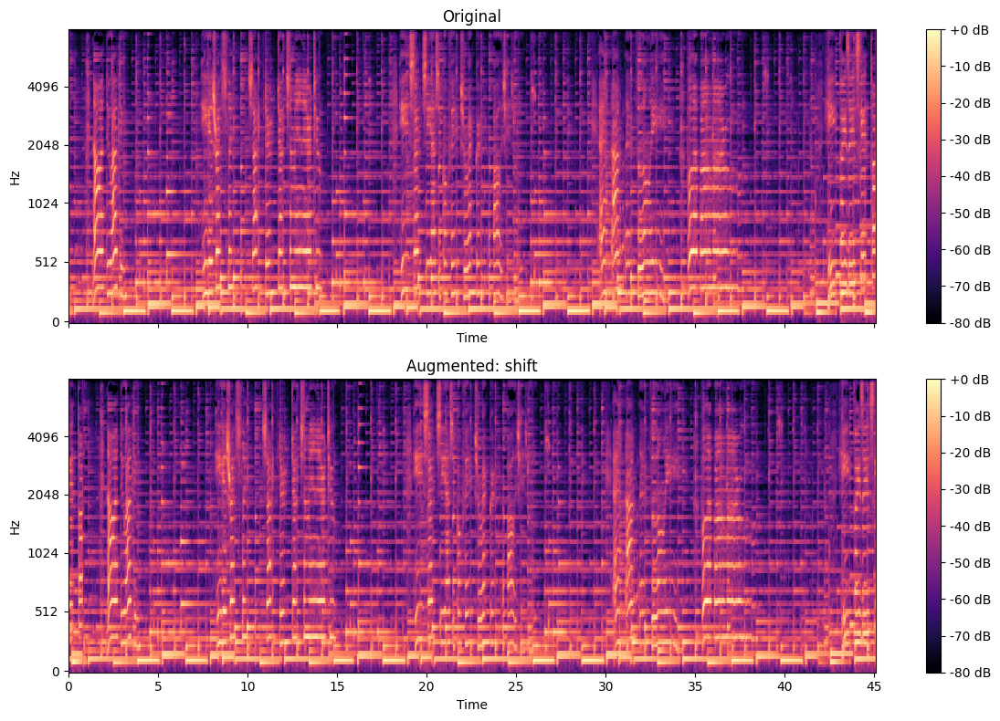

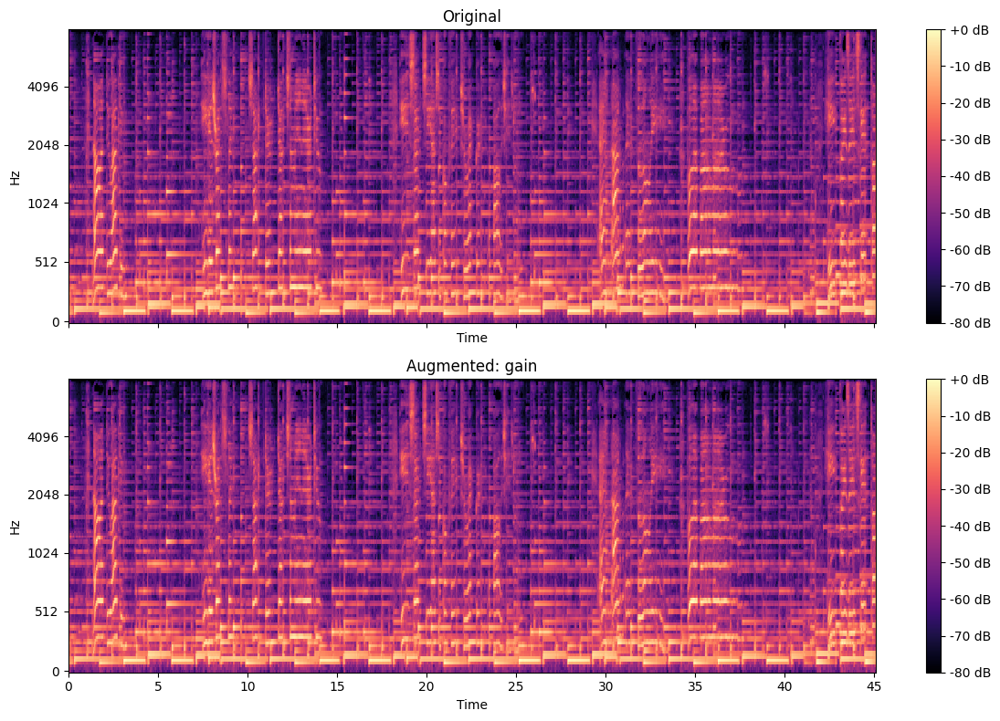

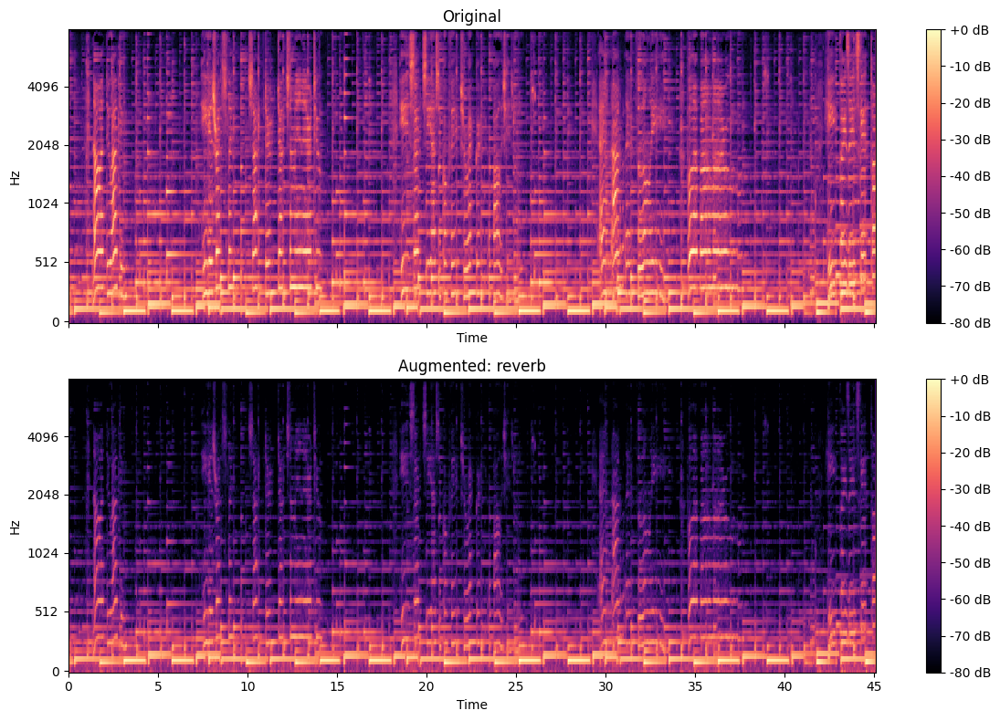

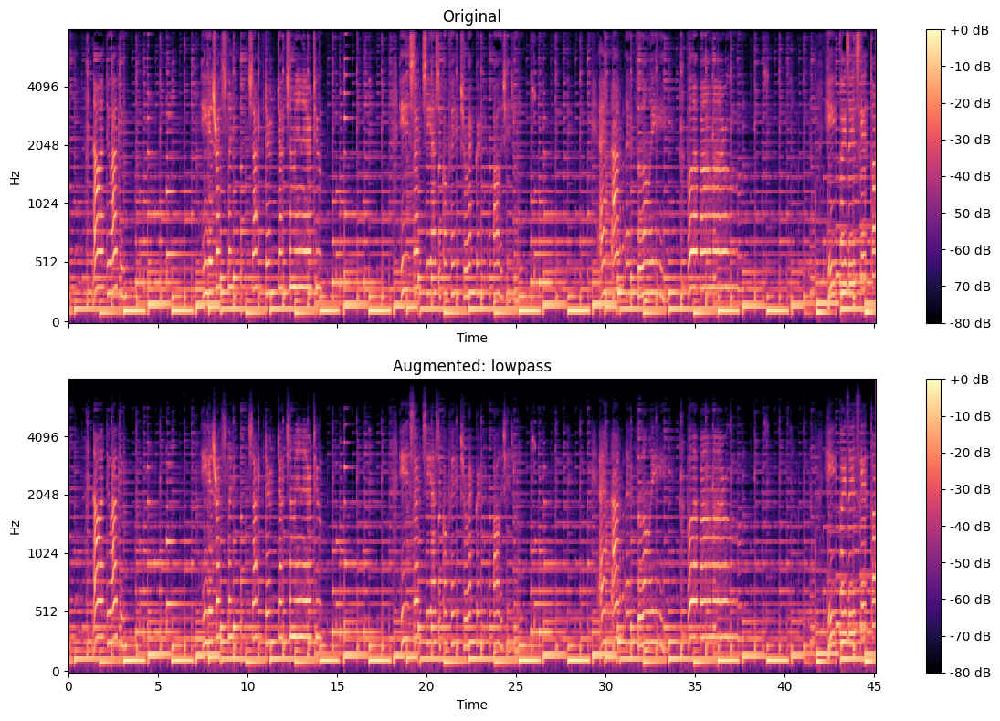

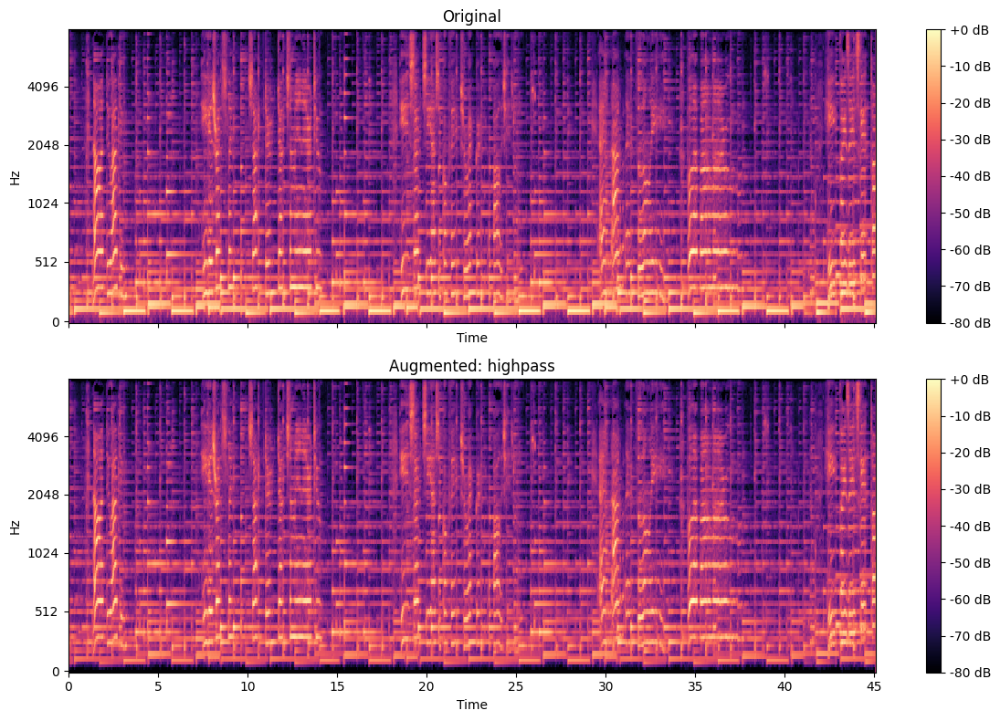

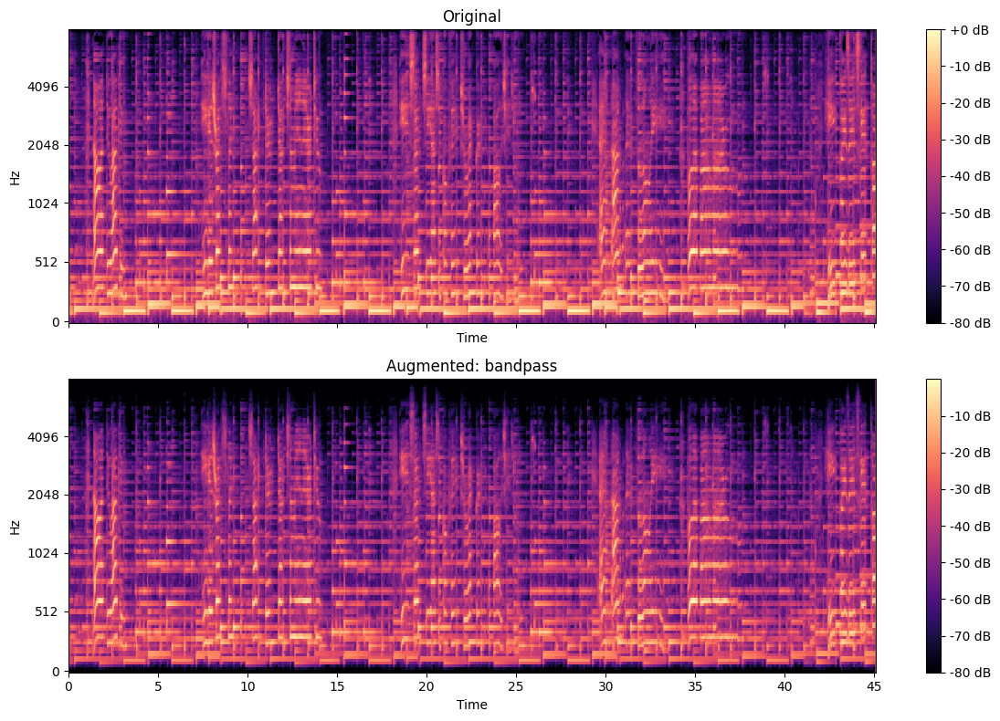

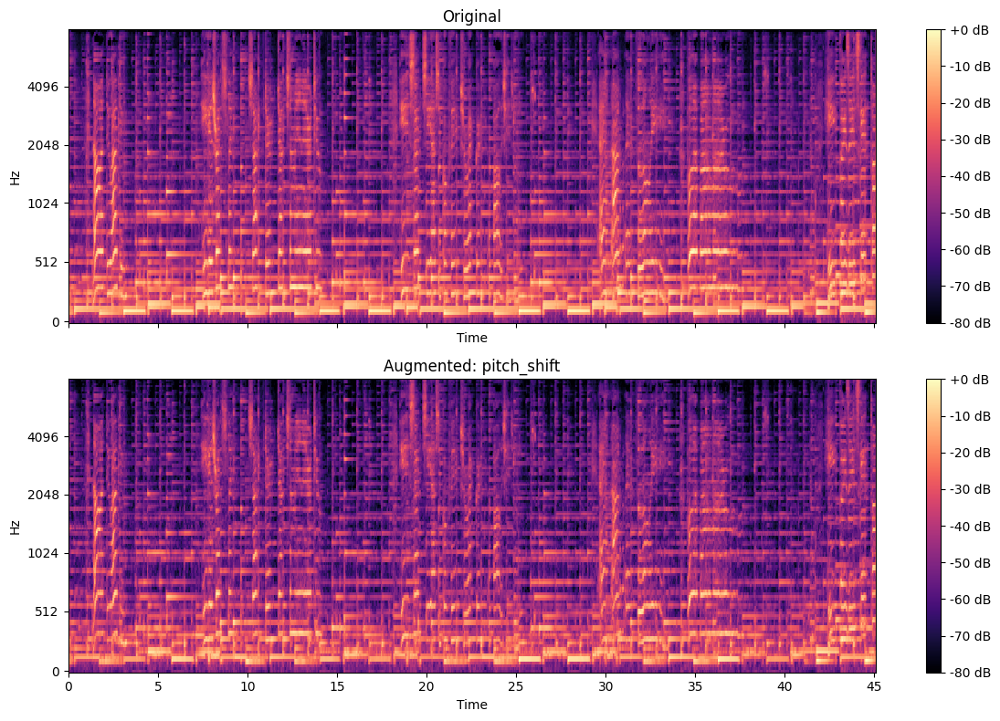

In [55]:
for name, func in augmentations.items():
    y_aug = func(y.copy())
    compare_augmentation(y, y_aug, SAMPLE_RATE, name)


In [56]:
def compute_fft(y, sr):
    Y = np.fft.rfft(y)
    freqs = np.fft.rfftfreq(len(y), d=1/sr)
    magnitude = np.abs(Y)
    return freqs, magnitude

def compare_fft_single_plot(y, y_aug, sr, name):
    freqs, mag_orig = compute_fft(y, sr)
    _, mag_aug = compute_fft(y_aug, sr)

    plt.figure(figsize=(12, 5))
    plt.plot(freqs, mag_orig, label="Original")
    plt.plot(freqs, mag_aug, label=f"Augmented – {name}", alpha=0.7)

    plt.title(f"FFT Spectrum – {name}")
    plt.xlabel("Frequency [Hz]")
    plt.ylabel("Magnitude")
    plt.legend()
    plt.grid(True)
    plt.tight_layout()
    plt.show()



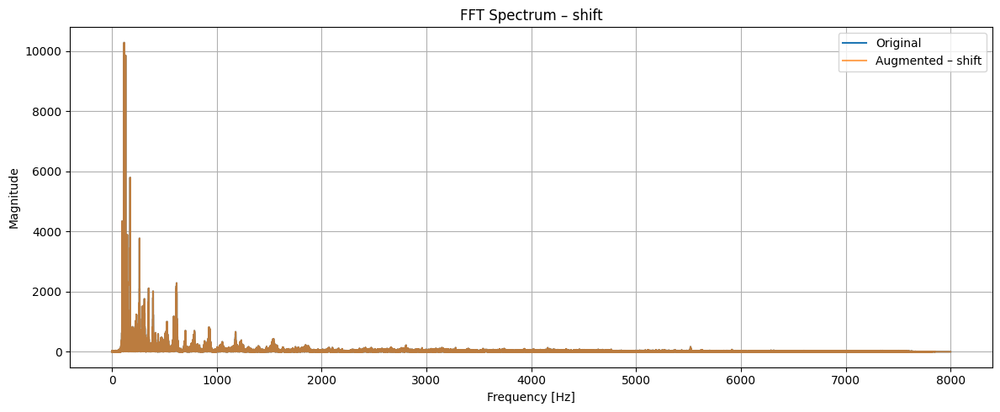

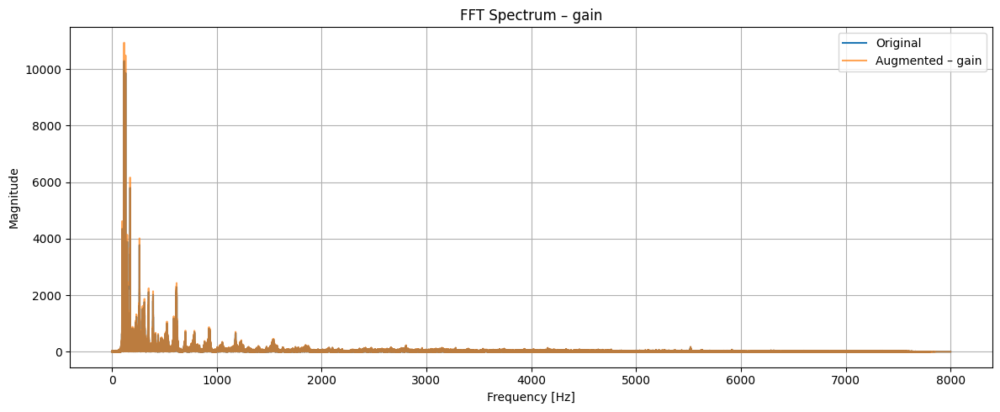

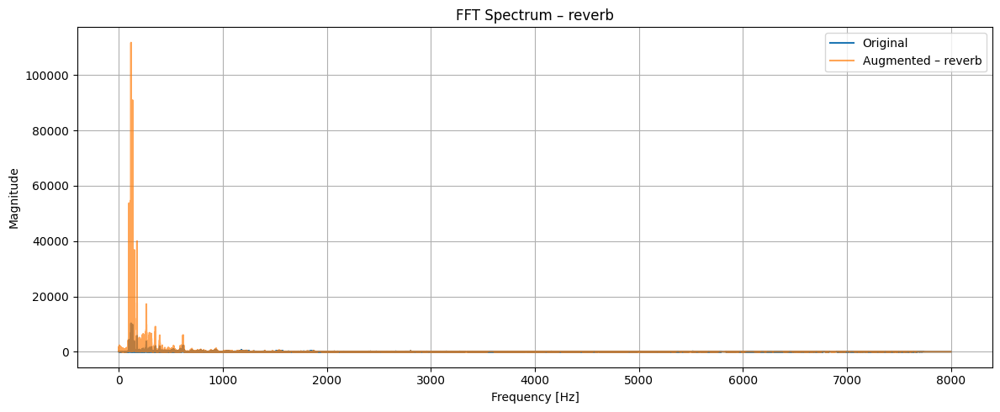

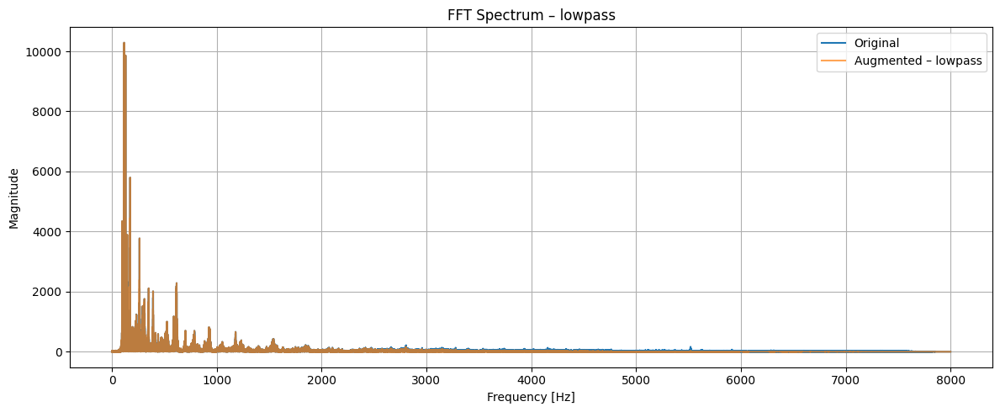

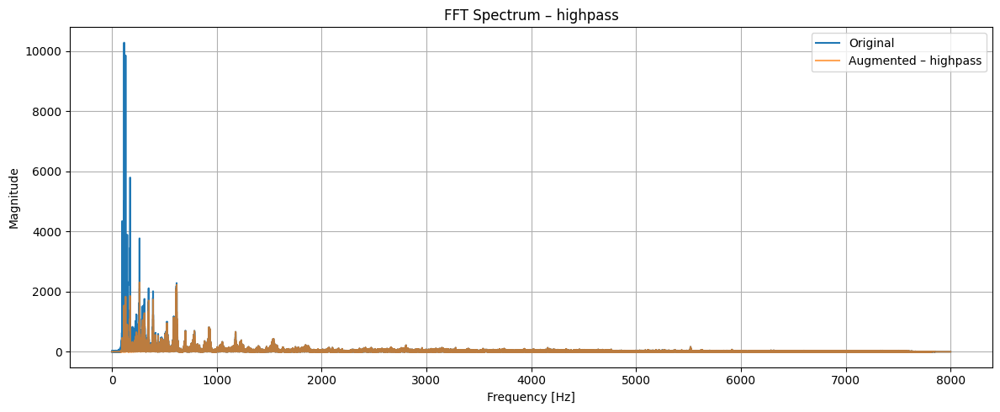

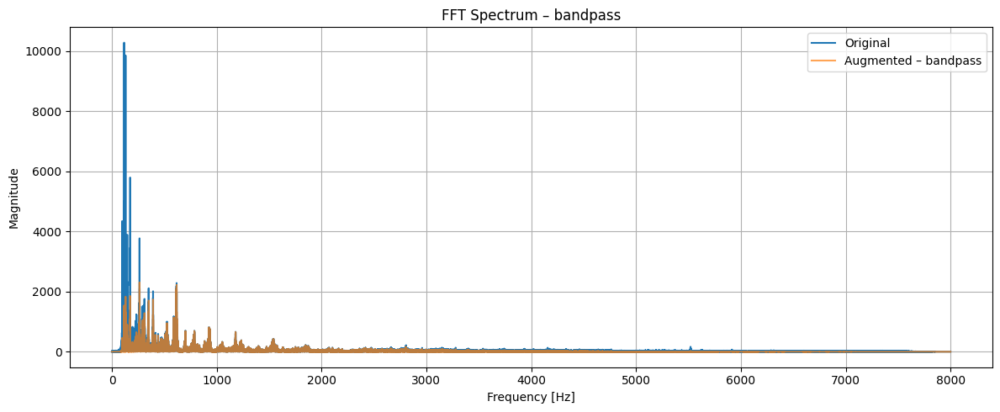

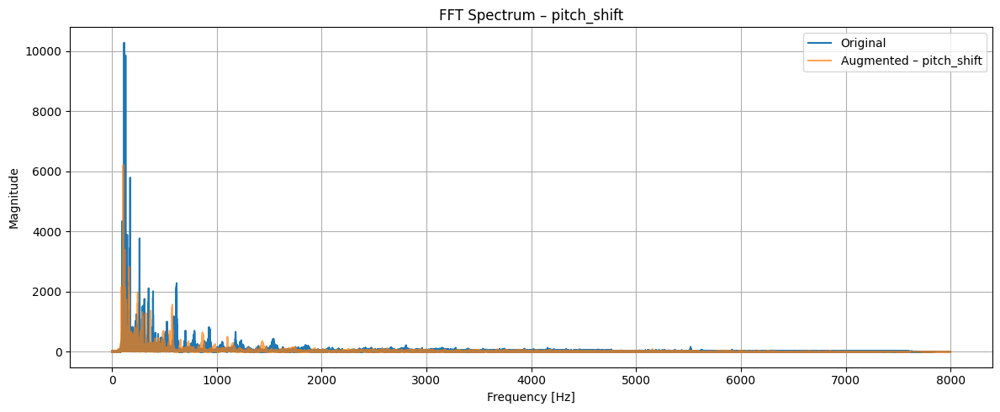

In [57]:
for name, func in augmentations.items():
    y_aug = func(y.copy())
    compare_fft_single_plot(y, y_aug, SAMPLE_RATE, name)
